# **Домашнее задание №1 (base)**

В этом домашнем задании вам будет необходимо:
*  обучить модель регрессии для предсказания стоимости автомобилей;
* реализовать веб-сервис для применения построенной модели на новых данных

**Максимальная оценка за дз**
> Оценка за домашку = $min(\text{ваш балл}, 11)$

**Мягкий дедлайн: 27 ноября 23:59**

**Жесткий дедлайн: 20 декабря 23:59 (конец модуля)**


**Примечание**

В каждой части оцениваются как код, **так и ответы на вопросы.** Вопросы подсвечены синим цветом.

Если нет одного и/или другого, то часть баллов за соответствующее задание снимается.

In [193]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import seaborn as sns

random.seed(42)
np.random.seed(42)

**Задание 0 (0 баллов).**
Для чего фиксируем сиды в домашках?

`Your answer here`

# **Часть 1 | EDA и визуализация**

Первая часть состоит из классических шагов EDA:

- Базовый EDA и обработка признаков (2.5 балла)
- Визуализации признаков и их анализ (1 балл)

Всего можно набрать 3.5 основных балла и 0.65 бонусных. Бонусные задания выделены как **Дополнительное задание/Бонус**. Вы можете выполнять их, чтобы в случае ошибок в основных задачах всё равно набрать за работу максимум. Кроме того, дополнительные задания позволяют вам углубить знания.

Призываем активно использовать их!

## **Простейший EDA и обработка признаков (2.5 балла)**

In [246]:
df_train = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_train.csv')
df_test = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_test.csv')

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

Train data shape: (6999, 13)
Test data shape:  (1000, 13)


### **Задание 1 (0.55 балла)**

Выполните операции, направленные на практику основных действий с `pandas`:
- [ ] Отобразите 10 случайных строк тренировочного датасета (0.15 балла)
- [ ] Отобразите первые 5 и последние 5 объектов тестового датасета (0.1 балла)
- [ ] Посмотрите, есть ли в датасете пропуски. Запишите/выведите названия колонок, для которых есть пропущенные значения (0.1 балла)
- [ ] Посмотрите, есть ли в данных явные дубликаты (0.05 балла)


**Бонус**
- [ ] Постройте дашборд, используя [ydata-profilling](https://github.com/ydataai/ydata-profiling)(0.15 балла)

In [ ]:
df_train.sample(10)


,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
4606,Hyundai Verna Transform VGT CRDi,2010,220000,80000,Diesel,Individual,Manual,Second Owner,16.2 kmpl,1493 CC,110 bhp,24 KGM at 1900-2750 RPM,5.0
3985,Mahindra Scorpio 1.99 S4,2016,750000,70000,Diesel,Individual,Manual,First Owner,15.4 kmpl,1997 CC,120 bhp,280Nm@ 1800-2800rpm,7.0
1564,Mahindra Quanto C2,2013,450000,52000,Diesel,Individual,Manual,First Owner,17.21 kmpl,1493 CC,100 bhp,240Nm@ 1600-2800rpm,7.0
351,Maruti Eeco CNG 5 Seater AC,2020,409999,35000,CNG,Individual,Manual,First Owner,20.88 km/kg,1196 CC,61.7 bhp,85Nm@ 3000rpm,5.0
5195,Maruti Swift VDI Optional,2015,600000,80000,Diesel,Individual,Manual,First Owner,25.2 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
4936,Hyundai i10 Magna LPG,2013,275000,70000,LPG,Individual,Manual,Second Owner,19.2 km/kg,1086 CC,68.05 bhp,99.04Nm@ 4500rpm,5.0
2119,Chevrolet Spark 1.0 LT,2011,160000,49563,Petrol,Dealer,Manual,First Owner,16.2 kmpl,995 CC,62.1 bhp,90.3Nm@ 4200rpm,5.0
1108,Fiat Grande Punto 1.3 Emotion Pack 90HP (Diesel),2011,280000,200000,Diesel,Individual,Manual,First Owner,20.5 kmpl,1248 CC,91.7 bhp,209Nm@ 2000rpm,5.0
2235,Chevrolet Sail 1.2 LS ABS,2014,310000,35000,Petrol,Individual,Manual,First Owner,18.2 kmpl,1199 CC,82.4 bhp,108.5Nm@ 5000rpm,5.0
2876,Tata Nexon 1.2 Revotron XZ Plus,2018,790000,15000,Petrol,Individual,Manual,First Owner,17.0 kmpl,1198 CC,108.5 bhp,170Nm@ 1750-4000rpm,5.0


In [ ]:
df_test.head(5)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.0 kmpl,2498 CC,112 bhp,260 Nm at 1800-2200 rpm,7.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.5 kmpl,1497 CC,108.5 bhp,260Nm@ 1500-2750rpm,5.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.9 kmpl,1799 CC,130 bhp,172Nm@ 4300rpm,5.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.1 kmpl,1498 CC,98.6 bhp,200Nm@ 1750rpm,5.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.5 kmpl,1172 CC,65 bhp,96 Nm at 3000 rpm,5.0


In [ ]:
df_test.tail(5)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
995,Hyundai i10 Magna 1.1L,2008,250000,100000,Petrol,Individual,Manual,Second Owner,19.81 kmpl,1086 CC,68.05 bhp,99.04Nm@ 4500rpm,5.0
996,Hyundai i20 2015-2017 Sportz 1.2,2017,440000,50000,Petrol,Individual,Manual,Second Owner,18.6 kmpl,1197 CC,81.83 bhp,114.7Nm@ 4000rpm,5.0
997,Hyundai i20 Era Diesel,2009,340000,40000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
998,Hyundai i10 Asta,2012,350000,25000,Petrol,Individual,Manual,First Owner,20.36 kmpl,1197 CC,78.9 bhp,111.8Nm@ 4000rpm,5.0
999,Honda City i DTec SV,2016,700000,110000,Diesel,Individual,Manual,First Owner,26.0 kmpl,1498 CC,98.6 bhp,200Nm@ 1750rpm,5.0


In [ ]:
print("Колонки с пропусками в тренировочном наборе:", df_train.columns[df_train.isnull().any()])
print("Колонки с пропусками в тестовом наборе:", df_test.columns[df_test.isnull().any()])

Пропуски в тренировочном наборе: Index(['mileage', 'engine', 'max_power', 'torque', 'seats'], dtype='object')
Пропуски в тестовом наборе: Index(['mileage', 'engine', 'max_power', 'torque', 'seats'], dtype='object')


In [ ]:
print(f"Количество дубликатов в тренировочном наборе: {df_train.duplicated().sum()}")
print(f"Количество дубликатов в тестовом наборе: {df_test.duplicated().sum()}")

Количество дубликатов в тренировочном наборе: 985
Количество дубликатов в тестовом наборе: 62


In [ ]:
!pip install ydata_profiling

In [ ]:
from ydata_profiling import ProfileReport

profile_train = ProfileReport(df_train, title="Train profile")
profile_train.to_widgets()


/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:528: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:

profile_test = ProfileReport(df_test, title="Test profile")
profile_test.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Мы обнаружили пропуски. Давайте избавимся от них.

- [ ] Заполните пропуски в столбцах медианами. Убедитесь, что после заполнения пропусков не осталось. Заполнение пропусков проводите для обоих наборов данных, если необходимо

**Важно!**

При заполнении пропусков и в тестовом, и тренировочном наборах данных вы определяетесь со стратегией предобработки пропущенных значений при потенциальной работе модели.

Так как в теоретическом случае вы не имеете доступа к тестовой выборке, то заполняемой значение (у нас — медиана) вы считаете про *тренировочному* набору данных и им же заполняете *тестовый*.

### **Задание 2 (0.5 балла)**

- [ ] Посмотрите, есть ли в трейне объекты с одинаковым признаковым описанием (целевую переменную следует исключить). Если есть, то сколько? (0.1 балла)
- [ ] Отобразите такие объекты (0.15 балла)
- [ ] Удалите повторяющиеся строки. Если при одинаковом признаковом описании цены на автомобили отличаются, то оставьте первую строку по этому автомобилю (0.15 балла)
- [ ]  Обновите индексы строк таким образом, чтобы они шли от 0 без пропусков (0.1 балла)


In [247]:
columns_without_target = [col for col in df_train.columns if col != "selling_price"]
duplicates = df_train[df_train.duplicated(subset=columns_without_target, keep=False)]
print(f"Количество объектов с одинаковым признаковым описанием: {len(duplicates)}")
duplicates


Количество объектов с одинаковым признаковым описанием: 1799


,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
22,Maruti Baleno Delta 1.2,2016,575000,45000,Petrol,Individual,Manual,First Owner,21.4 kmpl,1197 CC,83.1 bhp,115Nm@ 4000rpm,5.0
26,Maruti Omni E MPI STD BS IV,2018,254999,25000,Petrol,Individual,Manual,First Owner,16.8 kmpl,796 CC,34.2 bhp,59Nm@ 2500rpm,8.0
27,Maruti Vitara Brezza LDi Option,2017,670000,70000,Diesel,Individual,Manual,First Owner,24.3 kmpl,1248 CC,88.5 bhp,200Nm@ 1750rpm,5.0
28,Fiat Palio 1.2 ELX,2003,70000,50000,Petrol,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN
29,Maruti Omni 8 Seater BSIV,2012,150000,35000,Petrol,Individual,Manual,Second Owner,14.0 kmpl,796 CC,35 bhp,6.1kgm@ 3000rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6981,Ford Freestyle Titanium Plus Diesel BSIV,2018,750000,24000,Diesel,Individual,Manual,First Owner,24.4 kmpl,1498 CC,98.63 bhp,215Nm@ 1750-3000rpm,5.0
6984,Ford Freestyle Titanium Plus Diesel BSIV,2018,746000,24000,Diesel,Individual,Manual,First Owner,24.4 kmpl,1498 CC,98.63 bhp,215Nm@ 1750-3000rpm,5.0
6989,Maruti Swift Dzire VDI,2015,625000,50000,Diesel,Individual,Manual,First Owner,26.59 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
6997,Tata Indigo CR4,2013,290000,25000,Diesel,Individual,Manual,First Owner,23.57 kmpl,1396 CC,70 bhp,140Nm@ 1800-3000rpm,5.0


In [248]:
df_train = df_train.drop_duplicates(subset=columns_without_target, keep='first')

df_train.reset_index(drop=True, inplace=True)

In [197]:
assert df_train.shape == (5840, 13)

Отлично! Мы избавились от маленьких и явных проблем. Теперь перейдем к более сложным недостаткам полученной таблицы.

### **Задание 3 (0.25 балла)**

Вы могли заметить, что с признаками ``mileage, engine, max_power и torque`` всё не очень хорошо. Они распознаются как строки (можно убедиться в этом, вызвав `data.dtypes`). Однако эти переменные не являются категориальными — они — числа. Соответственно, нужно привести их к числовому виду.

**Задача :**
* [ ] Уберите единицы измерения для признаков ``mileage, engine, max_power``.
* [ ] Приведите тип данных к ``float``.
* [ ] Удалите столбец ``torque``


**Важно**
- Все действия нужно производить над обоими датасетами — `train` и `test`.
- Стобец ``torque`` мы удаляем для простоты. В идеальном случае, его также стоило бы предобработать.

In [249]:
for data in [df_train, df_test]:
    for col in ['mileage', 'engine', 'max_power']:
        data[col] = pd.to_numeric(data[col].str.split().str.get(0), errors='coerce')
    data.drop(columns=['torque'], inplace=True)


### **Задание 4 (0.1 балла)**

Теперь, когда не осталось пропусков, давайте преобразуем столбцы к более подходящим типам. А именно столбцы ``engnine`` и ``seats`` к приведем к `int`.

- [ ] Осуществите приведение столбцов к необходимому типу.

In [250]:
for data in [df_train, df_test]:
    data['engine'] = pd.to_numeric(data['engine'], errors='coerce').astype('Int64')
    data['seats'] = pd.to_numeric(data['seats'], errors='coerce').astype('Int64')

In [251]:
median_values = df_train.median(numeric_only=True)

df_train.fillna(median_values, inplace = True)
df_test.fillna(median_values, inplace = True)

print("Пропуски в тренировочном наборе после заполнения:")
print(df_train.isnull().sum())

print("Пропуски в тестовом наборе после заполнения:")
print(df_test.isnull().sum())

Пропуски в тренировочном наборе после заполнения:
name             0
year             0
selling_price    0
km_driven        0
fuel             0
seller_type      0
transmission     0
owner            0
mileage          0
engine           0
max_power        0
seats            0
dtype: int64
Пропуски в тестовом наборе после заполнения:
name             0
year             0
selling_price    0
km_driven        0
fuel             0
seller_type      0
transmission     0
owner            0
mileage          0
engine           0
max_power        0
seats            0
dtype: int64


### **Задание 5 (0.1 балла)**

Отлично! Мы провели "косметическую" предобработку и теперь готовы сделать важный шаг в контексте анализа данных. А именно — посмотреть на статистики!

**Ваша задача:**
- [ ] Посчитайте основные статистики по числовым столбцам для трейна и теста
- [ ] Посчитайте основные статистики по категориальным столбцам для трейна и теста

**Подсказка:**

Используте ``.describe()`` с нужным(и) аргументом(-ами).

**Примечание:**

Более корректно рассматривать статистики до заполнения пропусков и после, чтобы убедиться, что мы не внесли каких-либо серьезных сдвигов в изначальные рапсределения.

In [ ]:
print(df_train.describe())
print(df_test.describe())

categorical_columns = df_train.select_dtypes(include=['object']).columns
print(df_train[categorical_columns].describe())
print(df_test[categorical_columns].describe())

              year  selling_price     km_driven      mileage       engine  \
count  5840.000000   5.840000e+03  5.840000e+03  5654.000000       5654.0   
mean   2013.428425   5.229601e+05  7.395224e+04    19.432842  1435.418111   
std       4.095622   5.354320e+05  6.007114e+04     4.051002   492.453262   
min    1983.000000   2.999900e+04  1.000000e+00     0.000000        624.0   
25%    2011.000000   2.500000e+05  3.900000e+04    16.800000       1197.0   
50%    2014.000000   4.050000e+05  7.000000e+04    19.370000       1248.0   
75%    2017.000000   6.400000e+05  1.000000e+05    22.320000       1498.0   
max    2020.000000   1.000000e+07  2.360457e+06    42.000000       3604.0   

         max_power    seats  
count  5656.000000   5654.0  
mean     88.103070  5.44075  
std      32.131943  0.99527  
min       0.000000      2.0  
25%      68.000000      5.0  
50%      81.860000      5.0  
75%     100.000000      5.0  
max     400.000000     14.0  
              year  selling_price   

In [ ]:
assert df_train.shape == (5840, 13)

AssertionError: 

## **Визуализации (1 балл + 0.5 бонус)**



Визуализация данных — важный шаг в работе. Визуализировать данные необходимо, например, чтобы:

- Оценить распределения признаков самих по себе (это может натоклнуть вас на мысли о модели, которую можно использовать)
- Сравнить распределения на `train` и `test` — чтобы проверить, насколько информация, на которой вы будете обучаться согласуется с той, на которой модель должна работать
- Оценить есть ли явная связь признаков с целевой переменной

**Важно:**

Если распределения на `train` и `test` не совпадают, это не значит, что нужно перемешивать данные! Более корректно актуализировать задачу и уточнить, а не устарели ли данные `train`. Также полезным может быть собрать новую тестовую выборку, смешав те, что имеются сейчас.

**Если вы будете подгонять распределения, то можете встретиться с переобучением!**

### **Задание 6 (0.5 балла)**

Шаг 1.
- [ ] Воспользуйтесь `pairplot` из библиотеки `seabron`, чтобы визуализировать попарные распределения числовых признаков для `train`
- [ ] По полученному графику ответьте на вопросы:
 - Можно ли предположить на основе распределений связь признаков с целевой переменной?
 - Можно ли предположить на основе распределений выдвинуть гипотезу о корреляциях признаков?

Шаг 2.

- [ ] Постройте pairplot по тестовым данным
- [ ] Ответьте на вопрос "Похожими ли оказались совокупности при разделении на трейн и тест?"

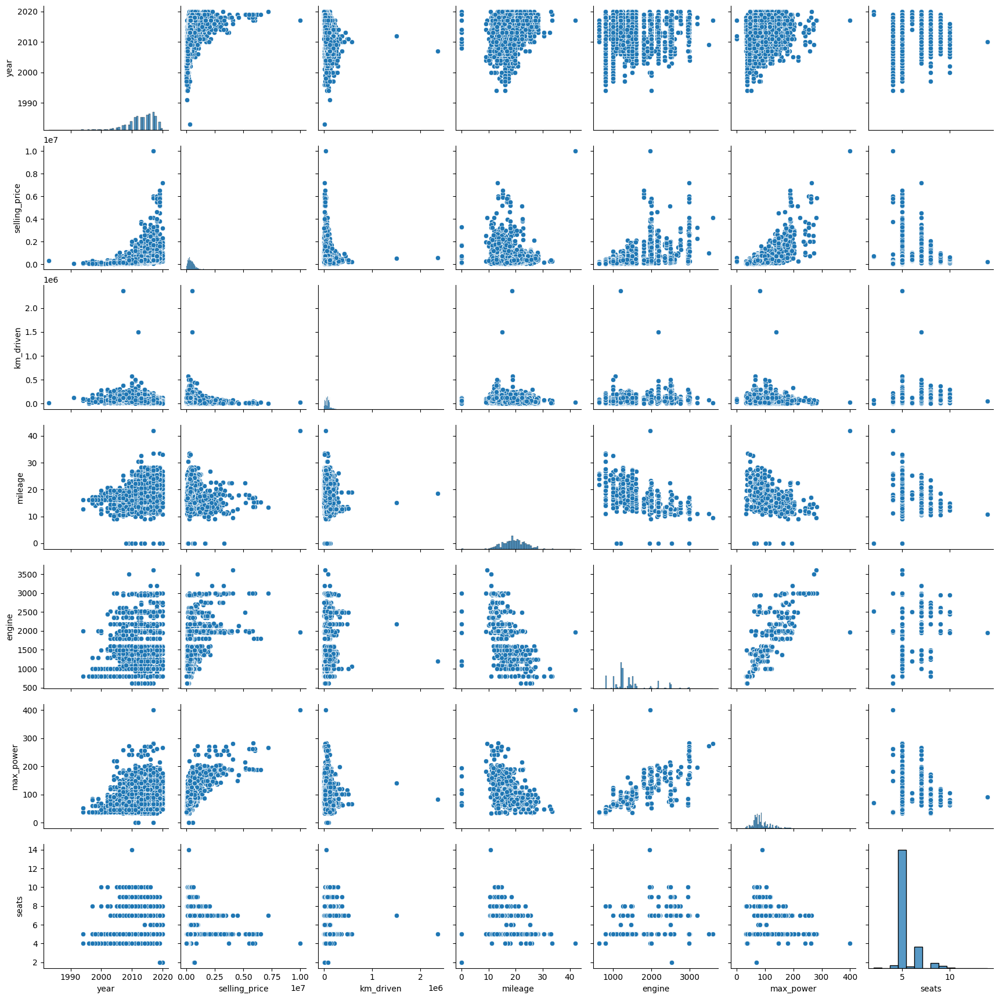

In [ ]:
sns.pairplot(df_train)

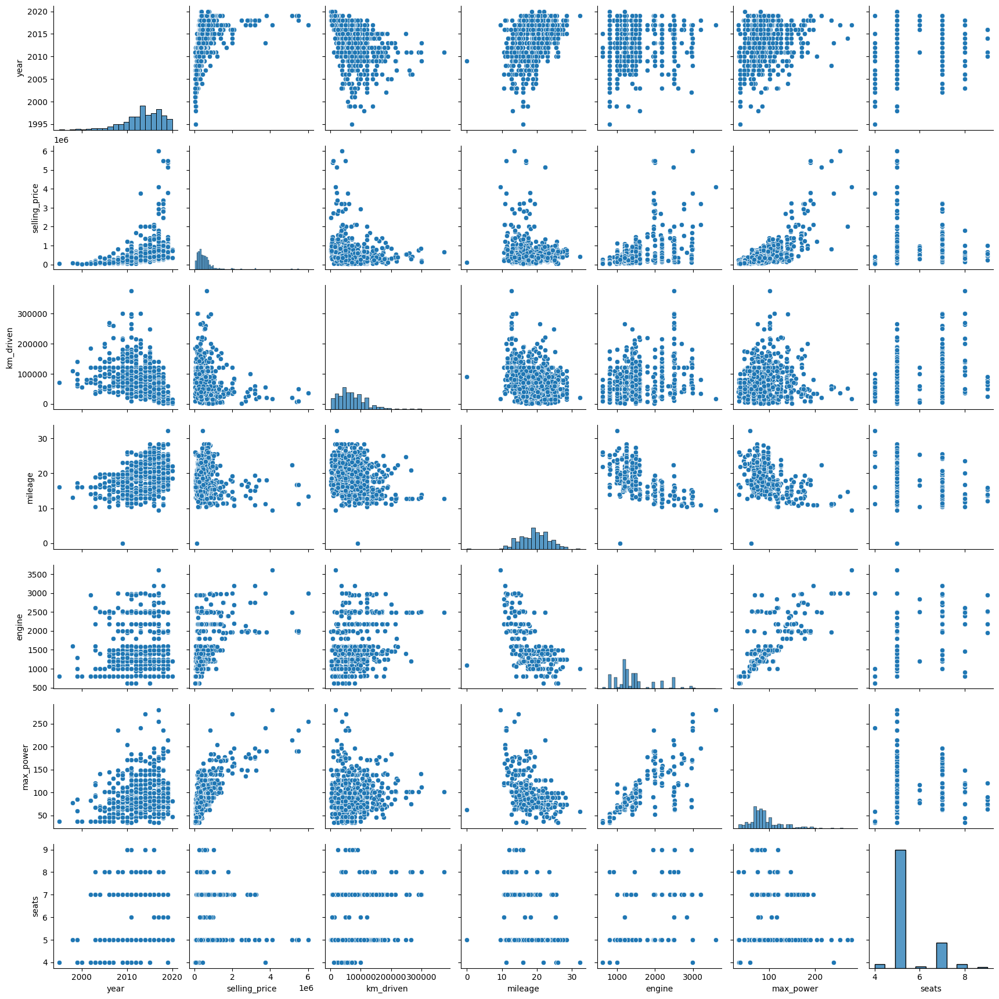

In [ ]:
sns.pairplot(df_test)

- Да, так как между ними есть линейные зависимости
- Да, так как между ними есть линейные зависимости, что говорит о корреляции
- Да, они похожи

### **Задание 7 (0.5 балла)**

И так, вы выдвинули гипотезы о наличии связи. Теперь давайте оценим эту связь в числах.

**Задание:**
- [ ] Получите значения коэффициента корреляции Пирсона для тренировочного набора данных при помощи `pd.corr()`
- [ ] По полученным корреляциям постройте тепловую карту (`heatmap` из бибилотеки seaborn)


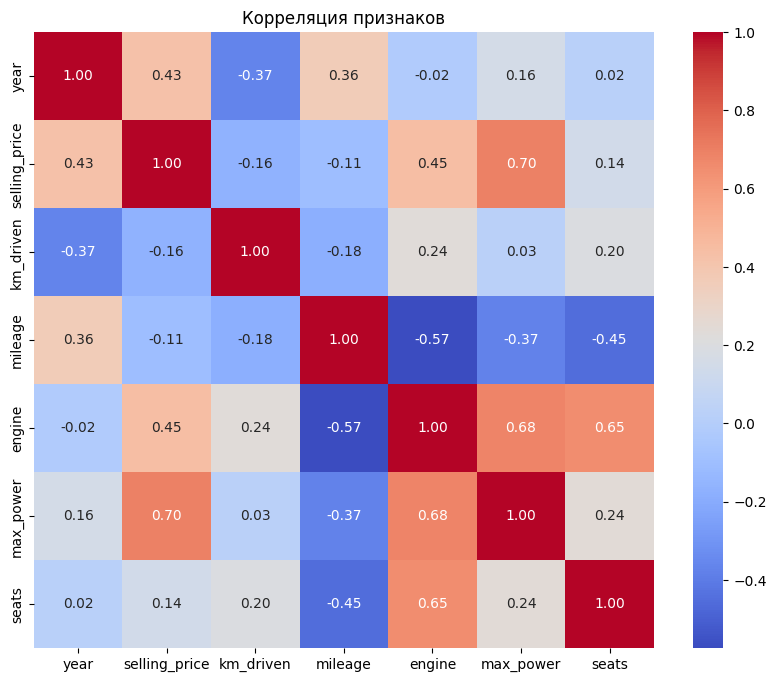

In [ ]:
correlation_matrix = df_train[df_train.select_dtypes(include=['float64', 'int64']).columns].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Корреляция признаков")
plt.show()

- [ ] Ответьте на вопросы:
 - Какие 2 признака наименее скоррелированы между собой?
 - Между какими наблюдается довольно сильная положительная линейная зависимость?
 - Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи?

- year и engine, year и seats
- max_power и selling_price
- да, так как корреляция между ними -0.37

### **Бонус (0.5 балла)**

Если вам кажется, что мы не попросили вас нарисовать какие-то очень важные зависимости, нарисуйте их **и поясните.**

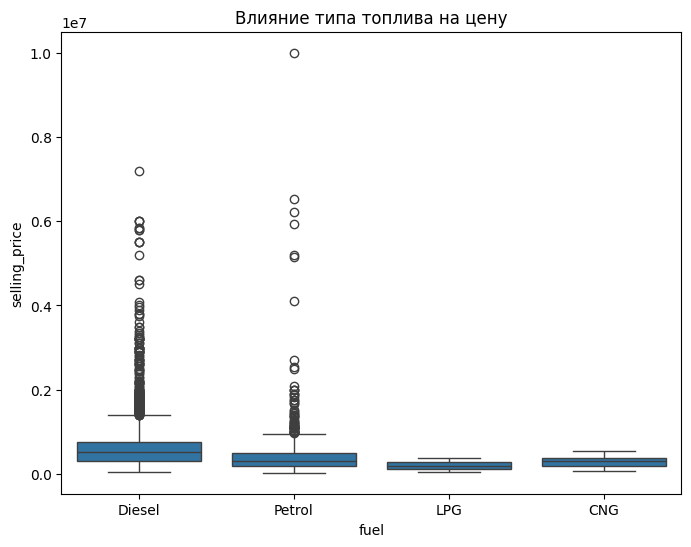

In [87]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='fuel', y='selling_price', data=df_train)
plt.title('Влияние типа топлива на цену')
plt.show()

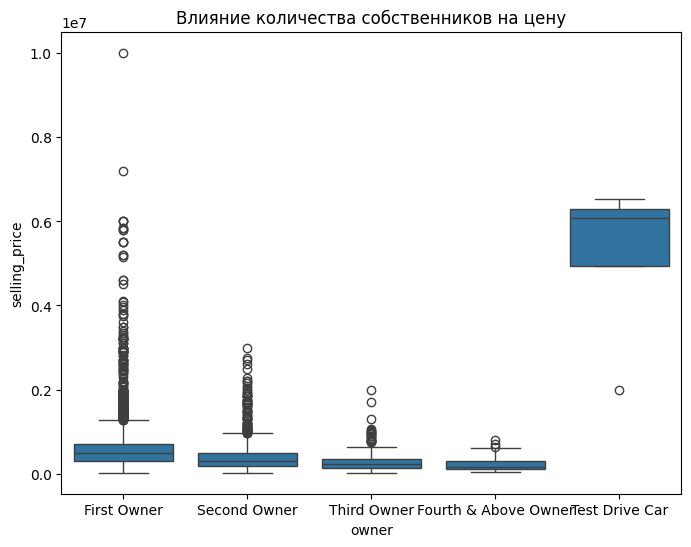

In [95]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='owner', y='selling_price', data=df_train)
plt.title('Влияние количества собственников на цену')
plt.show()

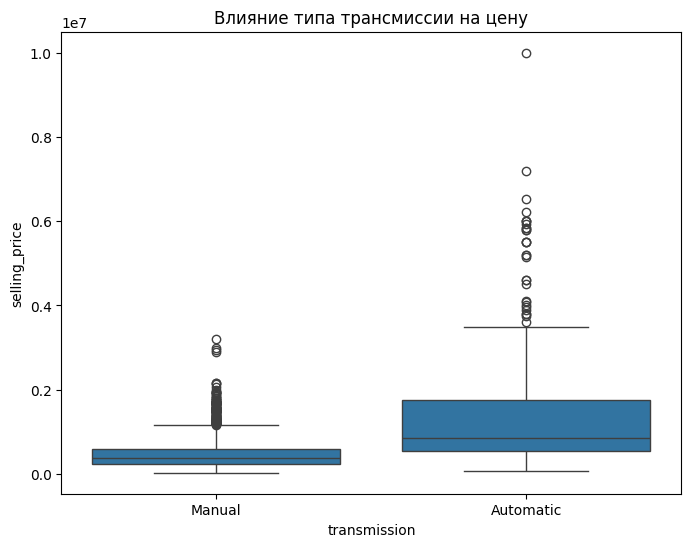

In [94]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='transmission', y='selling_price', data=df_train)
plt.title('Влияние типа трансмиссии на цену')
plt.show()

# **Часть 2 | Модель только на вещественных признаках**

В этой части вам предстоит обучить модель только на вещественных признаках. Почему только на них?

Чем больше признаковое пространство — чем сложнее модель. А чем модель проще — тем лучше для скорости работы и интерпретации признаков.

За задания этой части вы можете набрать 1.25 балла;

### **Задание 8 (0.05 балла)**

Разбейте данные на тренировочный и тестовый наборы. Перед разбиением создайте копию датафрейма, который будет хранить только вещественные признаки и используйте его (то есть категориальные столбцы (все, кроме seats) необходимо удалить).

В переменные y_train и y_test запишите значения целевых переменных.

In [135]:

df_train_numeric = df_train.drop(columns = categorical_columns)
df_test_numeric = df_test.drop(columns = categorical_columns)

X_train = df_train_numeric.drop(columns=['selling_price'])
y_train = df_train_numeric['selling_price']

X_test = df_test_numeric.drop(columns=['selling_price'])
y_test = df_test_numeric['selling_price']

assert X_train.shape == (5840, 6)
assert X_test.shape == (1000, 6)


In [136]:
assert X_train.shape == (5840, 6)

In [137]:
assert X_test.shape == (1000, 6)

### **Задание 9 (0.2 балла)**

Построим нашу первую модель!
- [ ] Обучите классическую линейную регрессию с дефолтными параметрами. Посчтитайте $R^2$ и $MSE$ для трейна и для теста.
- [ ] Сделайте выводы по значениям метрик качества.

**Примечание:**

Здесь и далее $R^2$ и $MSE$ для трейна и для теста выводите везде, где требуется обучать модели, даже если в явном виде этого не просят. Иначе непонятно, как понять, насколько успешны наши эксперименты.

In [138]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error as MSE

model = LinearRegression()
model.fit(X_train, y_train)

y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)
train_mse = MSE(y_train, y_train_pred)
test_mse = MSE(y_test, y_test_pred)

print(f"R2 for train: {train_r2}, MSE for train: {train_mse}")
print(f"R2 for test): {test_r2}, MSE for test: {test_mse}")
#Значения R² для train и test близки друг к другу, что говорит о том, что модель не переобучается
#MSE на тестовой выборке примерно в 2 раза выше, чем на тренировочной, что может говорить о наличии выбросов


R2 for train: 0.5922591702157316, MSE for train: 116874153930.02855
R2 for test): 0.5941419794788428, MSE for test: 233298779730.45486


### **Задание 10 (0.15 балла)**

Всегда есть место совершенству. Поэтому давайте попробуем улучшить модель. При помощи стандартизации признаков.

- [ ] Стандартизируйте значения в тренировочных и тестовых данных. Стандартизатор **обучайте только на `train`**.

In [140]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

model = LinearRegression()
model.fit(X_train_scaled, y_train)

y_train_pred = model.predict(X_train_scaled)
y_test_pred = model.predict(X_test_scaled)

train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)
train_mse = MSE(y_train, y_train_pred)
test_mse = MSE(y_test, y_test_pred)

print(f"R2 for train: {train_r2}, MSE for train: {train_mse}")
print(f"R2 for test): {test_r2}, MSE for test: {test_mse}")


R2 for train: 0.5922591702157303, MSE for train: 116874153930.02892
R2 for test): 0.594141979478852, MSE for test: 233298779730.44965


### **Задание 11 (0.1 балла)**

Хотя стандартизация не помогла сильно прибавить в качестве она открыла возможность интерпретировать важность признаков в модели. Правило интерпретации такое:

Чем больше коэффициент $\beta_i$ по модулю, тем важнее признак.

**Ответьте на вопрос:**

- [ ] Какой признак оказался наиболее информативным в предсказании цены?

In [143]:
pd.DataFrame({
    'Feature': X_train.columns,
    'Coefficient': model.coef_
}).sort_values(by='Coefficient', key=abs, ascending=False)
#max_power оказался наиболее информативным


,Feature,Coefficient
4,max_power,322807.353259
0,year,152772.570846
3,engine,61178.494337
1,km_driven,-44158.818520
2,mileage,28833.925778
5,seats,-23209.132486


### **Задание 12 (0.25 балла)**

Попробуем улучшить нашу модель с помощью применения регуляризации. Для этого воспльзуемся `Lasso` регрессией.  Кроме того, попробуйте использовать её теоретическое свойство отбора признаков, за счет зануления незначимых коэффициентов.

**Задание:**

- [ ] Обучите Lasso регрессию на тренировочном наборе данных с нормализованными признаками. Оцените её качество
- [ ] Проверьте, занулила ли L1-регуляризация с параметрами по умолчанию какие-нибудь веса? Предположите почему.

In [156]:
from sklearn.linear_model import Lasso

lasso_model = Lasso()
lasso_model.fit(X_train_scaled, y_train)

lasso_coefficients = pd.DataFrame({
    'Feature': X_train.columns,
    'Coefficient': lasso_model.coef_
}).sort_values(by='Coefficient', key=abs, ascending=False)

print("Коэффициенты Lasso-регрессии:")
print(lasso_coefficients)

y_train_pred_lasso = lasso_model.predict(X_train_scaled)
y_test_pred_lasso = lasso_model.predict(X_test_scaled)

train_r2_lasso = r2_score(y_train, y_train_pred_lasso)
test_r2_lasso = r2_score(y_test, y_test_pred_lasso)
train_mse_lasso = MSE(y_train, y_train_pred_lasso)
test_mse_lasso = MSE(y_test, y_test_pred_lasso)

print(f"Lasso R2 (train): {train_r2_lasso}, MSE (train): {train_mse_lasso}")
print(f"Lasso R2 (test): {test_r2_lasso}, MSE (test): {test_mse_lasso}")


Коэффициенты Lasso-регрессии:
     Feature    Coefficient
4  max_power  322808.236919
0       year  152772.390214
3     engine   61173.662409
1  km_driven  -44157.689858
2    mileage   28832.043396
5      seats  -23206.255649
Lasso R2 (train): 0.5922591701804456, MSE (train): 116874153940.1429
Lasso R2 (test): 0.5941408124026637, MSE (test): 233299450599.16928


- Lasso-регрессия не повлияла на метрики
- L1-регуляризация с параметрами по умолчанию не занулила веса, так как параметр alpha (сила регуляризации) слишком мал (по умолчанию 1)

### **Задание 13 Финальный рывок (0.5 балла)**

До этого мы с вами использовали `train` для обучения и `test` для прогнозирования. Но у нас есть ещё одна задача — подобрать оптимальные параметры модели. Для этого используем кросс-валидацию, описанную на семинарах.

Кроме того, выжмем максимум из модификаций регрессии. Построим `ElasticNet`. И сделаем всё по порядку.

**Ваша задача 1:**

- [ ] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для Lasso-регрессии. Вам пригодится класс [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html).
- [ ] Ответьте на вопросы:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Какой коэффициент регуляризации у лучшей из перебранных моделей? Занулились ли какие-нибудь из весов при такой регуляризации?

In [171]:
from sklearn.model_selection import GridSearchCV

param_grid = {'alpha': [0.01, 0.1, 1, 10, 100, 1000, 10000, 100000]}
lasso = Lasso()

grid_search_lasso = GridSearchCV(lasso, param_grid, cv=10)
grid_search_lasso.fit(X_train_scaled, y_train)

best_lasso = grid_search_lasso.best_estimator_
best_alpha = grid_search_lasso.best_params_['alpha']

print(f"Лучший коэффициент регуляризации: {best_alpha}")
print(f"Количество зануленных коэффициентов: {sum(best_lasso.coef_ == 0)}")


Лучший коэффициент регуляризации: 10000
Количество зануленных коэффициентов: 1


- 8 * 10 = 80


**Ваша задача 2:**

- [ ] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для [ElasticNet](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html) регрессии.
- [ ] Ответьте на вопрос:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Какие гиперпараметры соответствуют лучшей (по выбранной метрике качества) из перебранных моделей?

In [175]:
from sklearn.linear_model import ElasticNet

param_grid_en = {'alpha': [0.01, 0.1, 1, 10, 100, 1000, 10000, 100000],
                 'l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9]}
elastic_net = ElasticNet()

grid_search_en = GridSearchCV(elastic_net, param_grid_en, cv=10)
grid_search_en.fit(X_train_scaled, y_train)
# 8 * 5 * 10 = 400
best_elastic_net = grid_search_en.best_estimator_
best_params_en = grid_search_en.best_params_

print(f"Лучшие параметры: {best_params_en}")


Лучшие параметры: {'alpha': 1, 'l1_ratio': 0.9}


# **Часть 3| Добавляем категориальные фичи**

Попробуем для улучшения модели дать ей больше признаков. Добавим категориальные фичи.

За эту часть можно набрать 0.75 основных балла и 0.25 бонусных.


### **Задание 14 (0.1 балла)** Проанализируйте столбец `name`. Очевидно, что эта переменная является категориальной, однако категорий в ней много.

В этом домашнем задании мы предлагаем удалить его.

**Ваша задача:**
- [ ] Удалить столбец`name`

In [186]:
df_train.drop(columns=['name'])

,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats
0,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.40,1248,74.00,5
1,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14,1498,103.52,5
2,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.00,1396,90.00,5
3,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.10,1298,88.20,5
4,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14,1197,81.86,5
...,...,...,...,...,...,...,...,...,...,...,...
5835,2008,120000,191000,Petrol,Individual,Manual,First Owner,17.92,1086,62.10,5
5836,2013,260000,50000,Petrol,Individual,Manual,Second Owner,18.90,998,67.10,5
5837,2013,320000,110000,Petrol,Individual,Manual,First Owner,18.50,1197,82.85,5
5838,2007,135000,119000,Diesel,Individual,Manual,Fourth & Above Owner,16.80,1493,110.00,5


В другом случае, конечно, мы могли бы предобработать данный столбец. В качестве бонуса предлагаем вам придумать и реализовать алгоритм предобработки.

### **Бонус 0.5 балла**
- [ ] Предобработайте столбец `name`, чтобы избежать его удаления

In [252]:
from sklearn.preprocessing import OneHotEncoder

df_train["name"] = df_train["name"].str.split().str.get(0)
df_test["name"] = df_test["name"].str.split().str.get(0)

def OHE(name, df_train, df_test):
  ohe = OneHotEncoder(handle_unknown='ignore', sparse_output=False)

  train_encoded = ohe.fit_transform(df_train[[name]])
  test_encoded = ohe.transform(df_test[[name]])

  train_encoded = pd.DataFrame(train_encoded, columns=ohe.get_feature_names_out([name]))
  test_encoded = pd.DataFrame(test_encoded, columns=ohe.get_feature_names_out([name]))

  df_train_cat = pd.concat([df_train.drop(columns=name), train_encoded], axis=1)
  df_test_cat = pd.concat([df_test.drop(columns=name), test_encoded], axis=1)

  return df_train_cat, df_test_cat
df_train_cat, df_test_cat = OHE("name", df_train, df_test)
#assert X_train_cat.shape == (5840, 10)

In [ ]:
#X_train_cat.describe(include='object')

### **Задание 15 (0.4 балла)**

- [ ] Закодируйте категориалльные фичи и ``seats`` методом OneHot-кодирования. Обратите внимание, что во избежание мультиколлинеарности следует избавиться от одного из полученных столбцов при кодировании каждого признака методом OneHot.

In [253]:
from sklearn.preprocessing import OneHotEncoder # или можно использовать get_dummies из библиотеки pandas

categorical_features = [*df_train_cat.select_dtypes(include=['object']).columns, "seats"]

for feature in categorical_features:
  df_train_cat, df_test_cat = OHE(feature, df_train_cat, df_test_cat)

In [254]:
df_train_cat.columns

Index(['year', 'selling_price', 'km_driven', 'mileage', 'engine', 'max_power',
       'name_Ambassador', 'name_Audi', 'name_BMW', 'name_Chevrolet',
       'name_Daewoo', 'name_Datsun', 'name_Fiat', 'name_Force', 'name_Ford',
       'name_Honda', 'name_Hyundai', 'name_Isuzu', 'name_Jaguar', 'name_Jeep',
       'name_Kia', 'name_Land', 'name_Lexus', 'name_MG', 'name_Mahindra',
       'name_Maruti', 'name_Mercedes-Benz', 'name_Mitsubishi', 'name_Nissan',
       'name_Peugeot', 'name_Renault', 'name_Skoda', 'name_Tata',
       'name_Toyota', 'name_Volkswagen', 'name_Volvo', 'fuel_CNG',
       'fuel_Diesel', 'fuel_LPG', 'fuel_Petrol', 'seller_type_Dealer',
       'seller_type_Individual', 'seller_type_Trustmark Dealer',
       'transmission_Automatic', 'transmission_Manual', 'owner_First Owner',
       'owner_Fourth & Above Owner', 'owner_Second Owner',
       'owner_Test Drive Car', 'owner_Third Owner', 'seats_2.0', 'seats_4.0',
       'seats_5.0', 'seats_6.0', 'seats_7.0', 'seats_8.0', 's

### **Задание 16 (0.25 балла)**
Повторим то, что делали на прошлом шаге для моделей на вещественных признаках, однако теперь с моделью `Ridge`.


**Ваша задача:**
- [ ] Переберите параметр регуляризации `alpha` для гребневой (ridge) регрессии с помощью класса `GridSearchCV` В качестве параметров при объявлении GridSearchCV кроме модели укажите метрику качества $R^2$. Кроссвалидируйтесь по 10-ти фолдам.
- [ ] Ответье на вопрос: Удалось ли улучшить качество прогнозов?

In [259]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import Ridge

X_train = df_train_cat.drop(columns=['selling_price'])
y_train = df_train_cat['selling_price']

X_test = df_test_cat.drop(columns=['selling_price'])
y_test = df_test_cat['selling_price']

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

param_grid = {'alpha': [0.1, 1, 10, 100, 1000]}
ridge = Ridge()

grid_search_ridge = GridSearchCV(ridge, param_grid, cv=10, scoring='r2')
grid_search_ridge.fit(X_train_scaled, y_train)

best_ridge = grid_search_ridge.best_estimator_

y_train_pred = best_ridge.predict(X_train_scaled)
y_test_pred = best_ridge.predict(X_test_scaled)

train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)
train_mse = MSE(y_train, y_train_pred)
test_mse = MSE(y_test, y_test_pred)

print(f"Ridge R2 (train): {train_r2}, MSE (train): {train_mse}")
print(f"Ridge R2 (test): {test_r2}, MSE (test): {test_mse}")

best_ridge_alpha = grid_search_ridge.best_params_['alpha']

print(f"Лучший alpha для Ridge: {best_ridge_alpha}")
#качество прогнозов заметно улучшилось


Ridge R2 (train): 0.7736130668368189, MSE (train): 64891174347.832184
Ridge R2 (test): 0.7843284309134597, MSE (test): 123974176550.29294
Лучший alpha для Ridge: 100


# **Часть 4. | Бизнесовая (0.5 балла)**

### **Задание 17 (0.5 балла)**

В мире бизнеса очень важно давать оценку качества модели понятную бизнесу, поэтому иногда заказчики приходят с кастомными метриками. Попробуем сделать такую для нашей задачи.

**Описание метрики:**

Среди всех предсказанных цен на авто нужно посчитать долю прогнозов, отличающихся от реальных цен на эти авто не более чем на 10% (в одну или другую сторону)

**Ваша задача:**

- [ ] Реализуйте метрику `business_metric`
- [ ] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса

In [268]:
def business_metric(y_true, y_pred):
    differences = np.abs(y_pred - y_true)
    return np.mean(differences <= 0.1 * y_true)

linear_regression = LinearRegression()
linear_regression.fit(X_train_scaled, y_train)
regression_predictions = linear_regression.predict(X_test_scaled)
metric_regression = business_metric(y_test, regression_predictions)

lasso = Lasso()
lasso.fit(X_train_scaled, y_train)
lasso_predictions = lasso.predict(X_test_scaled)
metric_lasso = business_metric(y_test, lasso_predictions)

ridge_predictions = best_ridge.predict(X_test_scaled)
metric_ridge = business_metric(y_test, ridge_predictions)

print(f"Regression Business Metric: {metric_regression}")
print(f"Lasso Business Metric: {metric_lasso}")
print(f"Ridge Business Metric: {metric_ridge}")


Regression Business Metric: 0.321
Lasso Business Metric: 0.322
Ridge Business Metric: 0.321


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:697: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.520e+13, tolerance: 1.674e+11
  model = cd_fast.enet_coordinate_descent(


`Your answer here`

# **Часть 5 (3 балла) | Реализация сервиса на FastAPI**

### **Задание 18 (3 балла)**


Cделайте с помощью FastAPI сервис, который с точки зрения пользователя реализует две функции:

1. на вход в формате json подаются признаки одного объекта, на выходе сервис выдает предсказанную стоимость машины
2. на вход подается csv-файл с признаками тестовых объектов, на выходе получаем файл с +1 столбцом - предсказаниями на этих объектах

С точки зрения реализации это означает следующее:
- средствами pydantic должен быть описан класс базового объекта
- класс с коллецией объектов
- метод post, который получает на вход один объект описанного класса
- метод post, который получает на вход коллекцию объектов описанного класса

Шаблон для сервисной части дан ниже. Код необходимо дополнить и оформить в виде отдельного .py-файла.

In [ ]:
from fastapi import FastAPI
from pydantic import BaseModel
from typing import List

app = FastAPI()


class Item(BaseModel):
    name: str
    year: int
    selling_price: int
    km_driven: int
    fuel: str
    seller_type: str
    transmission: str
    owner: str
    mileage: str
    engine: str
    max_power: str
    torque: str
    seats: float


class Items(BaseModel):
    objects: List[Item]


@app.post("/predict_item")
def predict_item(item: Item) -> float:
    return ...


@app.post("/predict_items")
def predict_items(items: List[Item]) -> List[float]:
    return ...

Протестируйте сервис на корректность работы и приложите скриншоты (см. ниже).

# **Часть 6 (1 балл) | Оформление результатов**

### **Задание 19 (1 балл)**


**Результаты вашей работы** необходимо разместить в своем Гитхабе. Под результатами понимаем следующее:
* ``.ipynb``-ноутбук со всеми проведёнными вами экспериментами (output'ы ячеек, разумеется, сохранить)
* сохраненный дашборд в любом формате
* ``.py``-файл с реализацией сервиса
* ``.pickle``-файл с сохранёнными весами модели, коэффициентами скейлинга и прочими числовыми значениями, которые могут понадобиться для инференса
* ``.md``-файл с выводами про проделанной вами работе:
    * что было сделано
    * с какими результатами
    * что дало наибольший буст в качестве
    * что сделать не вышло и почему (это нормально, даже хорошо😀)

**За что могут быть сняты баллы в этом пункте:**
* за отсутствие ``.pickle``-файла с весами использованной модели
* за недостаточную аналитику в ``.md``-файле
* за оформление и логику кода (в определённом смысле это тоже элемент оформления решения)

**Как будет выглядет проверка всего домашнего задания?**
1. Ассистент проходит по ссылке на (**открытый**) репозиторий из Энитаска
2. Смотрит ``readme.md``:
    * пожалуйста, приложите в него же скрины работы вашего сервиса -- собирать ваши проекты довольно времязатратно, но хочется убедиться, что всё работает
    * можете в md-файл приложить ссылку на screencast с демонстрацией
3. Просматривает ноутбук с DS-частью
4. Заглядывает в код сервиса
5. Хвалит

# **Часть Благодарственная**

Надеемся, вы честно проделали все пункты, а не просто пролистали досюда. Потому что здесь награда за старания. Пожалуйста, не стоит награждать себя до того, как закончите работать над домашкой!

<details>
<summary><b>Что-то приятное</b></summary>

**Напоминаем, что нашем курсе действует система кото-бонусов** 🐈

На фото по ссылке — сэр кот кого-то из команды курса (преподаватель, помощник преподавателя, ассистенты).

Предлагаем вам угадать — чей это товарищ!

[Первый кот](https://ibb.co/XbnpCTg)

</details>

